# Capstone Project - The Battle of the Neighborhoods
## Coffee Industry in Medellín, Colombia
### Applied Data Science Capstone by IBM/Coursera


## Table of contents
* [Introduction: Business Problem](#introduction)
* [Data](#data)
* [Results and Discussion](#results)



## Introduction: Business Problem <a name="introduction"></a>

Colombia has a 11.5 million bags of coffee as average production by year, the third largest exporter in the planet (1. Brazil, 2. Vietnam) and one of the most visited destination for coffee lovers. The diversity of his geographical conditions is ideal for growing a large variety of beans. The coffee industry in Medellín has become more modern and more coffee specialists and independents cafes have appeared in the Medellín Coffee scene, sharing that scene with the traditional **"tinto"**, it is not the best coffee, but is a big part of coffee culture in Medellín.

In this project we will try to find an optimal location for a coffee shop. This report will be targeted to stakeholders interested in opening a **Cofee shop** or **Café** in **Medellín**, Colombia. We will try to detect where is located the most quantity of venues related with coffee, coffee shops, coffee pets or "cafés". We will find the distribution of cafes throughout the Medellín city both, by borough and by neighbourhood.
We will use data science to generate the best place to get a cofee shop in Medellín.

## Data <a name="data"></a>

Initially we need to create a dataframe that contains neighborhoods, boroughs and location (latitude, longitude).

With this geojson file https://opendata.arcgis.com/datasets/c844f0fd764f41b2a808d8747457de8a_4.geojson, that can be found in "Open data" a website of the Alcaldía de Medellín and using this webpage https://satellite-map.gosur.com/en/ll=6.230166081931358,-75.54311677878525&z=12.23069539645634&t=satellitemanually that have geographical coordinates in Medellín I added to the initial dataframe the coordinates of each neighbourhood.

After appropiate cleaning (eliminate columns and nulls), obtaining a wanted dataframe to get a general vision of Medellín and their neighborhoods. We need to get information about cofee shops, then pick up the zone where locates most of the cofee shops.

Using FourSquare to asset data and applying folium for visualizing a specific zone where are located the cofees.  
Based on definition of our problem, factors that will influence our decission are:
* number of existing cofees in the neighborhood.
* Location of existing cofees in the zone.


## Importing libraries

In [14]:
import requests # library to handle requests
import pandas as pd # library for data analsysis
import numpy as np # library to handle vectorized data  
import random # library for random number generation*


from geopy.geocoders import Nominatim
# libraries for displaying images
from IPython.display import Image 
from IPython.core.display import HTML 
    
# tranforming json file into a pandas dataframe library
from pandas.io.json import json_normalize

from sklearn.cluster import KMeans

%matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as colors

! pip install folium==0.5.0
import folium # plotting library
from folium import plugins

print('Folium installed')
print('Libraries imported.')

Folium installed
Libraries imported.


## Obtaining initial dataframe!

### Getting the json file from 

In [15]:
results = requests.get('https://opendata.arcgis.com/datasets/c844f0fd764f41b2a808d8747457de8a_4.geojson').json()

In [16]:
medellin = results['features'] #Getting dataframe from json
medellin = pd.json_normalize(medellin) #flatten json
#resp

# define the dataframe columns
column_names = ['Borough', 'Neighborhood', 'Latitude', 'Longitude'] 

# instantiate the dataframe
neighborhoods = pd.DataFrame(columns=column_names)

medellin
#Cleaning columns
medellin.columns = [col.split(".")[-1] for col in medellin.columns]
medellin
medellin.drop(['OBJECTID','SUBTIPO_BARRIOVEREDA','SHAPEAREA','SHAPELEN','type',], axis=1, inplace=True)
medellin.rename(columns={'CODIGO':'Id','NOMBRE':'Neighbourhood','NOMBRE_COMUNA_CORREGIMIENTO':'Borough','coordinates':'coordinates'}, inplace=True)
medellin = medellin[['Id','Borough','Neighbourhood']]
print('The dimensions of this dataframe are: ', medellin.shape)

The dimensions of this dataframe are:  (332, 3)


### Droping empty values from "Borough" column, and supriming rows of near municipalities. 

In [17]:
medellin.dropna(subset=['Borough'], inplace=True)
df_med = medellin[medellin['Borough'].str.contains('Corregimiento')==False]
print('The dimensions of this dataframe are: ', df_med.shape)

The dimensions of this dataframe are:  (269, 3)


In [18]:
df_med.head()

,Id,Borough,Neighbourhood
0,0510,Castilla,Tricentenario
1,0208,Santa Cruz,Villa Niza
2,1108,Laureles Estadio,Laureles
3,1303,San Javier,Santa Rosa de Lima
4,1206,La América,Santa Lucía


### Reading csv file containing geocoordinates (latitude, longitude) of each neighbourhood.

In [19]:
df_med_latlng=pd.read_csv('Medellin_neigh_coord.csv', sep =',')
#df_med_latlng['Latitude'] = df_med_latlng['Latitude'].astype(float)
#df_med_latlng['Longitude'] = df_med_latlng['Longitude'].astype(float)
df_med_latlng

,Id,Latitude,Longitude
0,1422,6.198600,-75.577200
1,0810,6.244487,-75.545700
2,0719,6.277633,-75.605593
3,0102,6.299473,-75.540104
4,0302,6.279339,-75.549459
...,...,...,...
264,0210,6.293352,-75.559008
265,0201,6.303206,-75.550125
266,0819,6.235378,-75.533431
267,1510,6.200365,-75.586085


### Merging Neighbourhoods with their coordinates.

In [20]:
df_merged=pd.merge(df_med,df_med_latlng,how='left', on=['Id'])
df_merged = df_merged[['Id','Borough','Neighbourhood','Latitude','Longitude']]
df_merged.head()

,Id,Borough,Neighbourhood,Latitude,Longitude
0,0510,Castilla,Tricentenario,6.291070,-75.566325
1,0208,Santa Cruz,Villa Niza,6.295645,-75.563450
2,1108,Laureles Estadio,Laureles,6.242000,-75.595833
3,1303,San Javier,Santa Rosa de Lima,6.265101,-75.606353
4,1206,La América,Santa Lucía,6.257436,-75.607385


In [21]:
#df_merged.to_excel('merged.xlsx')

### Eliminating null values!

In [22]:
df_merged.dropna(inplace=True)

# Knowing Medellín

In [23]:
print('The dataframe of Medellín has {} boroughs and {} neighborhoods.'.format
      (len(df_med['Borough'].unique()), df_med.shape[0]))

The dataframe of Medellín has 16 boroughs and 269 neighborhoods.


In [24]:
address = 'Medellín, Colombia'

geolocator = Nominatim(user_agent="foursquare_agent")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude

print('The geographical coordinates of Medellín are {}, {}.'.format(latitude, longitude))

The geographical coordinates of Medellín are 6.2443382, -75.573553.


# Medellín map

In [25]:
# create map of Medellín using latitude and longitude values
map_medellin = folium.Map(location=[latitude, longitude], zoom_start=13)


# add markers to map
for borough, neighborhood, lat, lng in zip(df_merged['Borough'], df_merged['Neighbourhood'], df_merged['Latitude'], df_merged['Longitude']):
    label = '{}, {}'.format(neighborhood, borough)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_medellin)  
    
map_medellin

## Getting Foursquare credentials

In [26]:
CLIENT_ID = 'Y1ZWMTG4CHTBHFYLQYMPKTY5DSZIJX0IIQ3DZF4PE5LVL1IT' # your Foursquare ID
CLIENT_SECRET = 'TX2SKMR2RVCTSNKPVRRGDLPWZGQ0CKQJWMQ012WNPQBXW3UD' # your Foursquare Secret
ACCESS_TOKEN = 'O3KQSPXI1BVP0QSOCBDKMRLXNQQEXPU1WKLZ0RBWJH41XHJI' # your FourSquare Access Token
VERSION = '20180604'
LIMIT = 100
print('Your credentials:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)

Your credentials:
CLIENT_ID: Y1ZWMTG4CHTBHFYLQYMPKTY5DSZIJX0IIQ3DZF4PE5LVL1IT
CLIENT_SECRET:TX2SKMR2RVCTSNKPVRRGDLPWZGQ0CKQJWMQ012WNPQBXW3UD


## Getting venues that are in Medellín

In [27]:
LIMIT = 100 # limit of number of venues returned by Foursquare API

radius = 500 # define radius

url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
    CLIENT_ID, 
    CLIENT_SECRET, 
    VERSION, 
    latitude, 
    longitude, 
    radius, 
    LIMIT)
url

'https://api.foursquare.com/v2/venues/explore?&client_id=Y1ZWMTG4CHTBHFYLQYMPKTY5DSZIJX0IIQ3DZF4PE5LVL1IT&client_secret=TX2SKMR2RVCTSNKPVRRGDLPWZGQ0CKQJWMQ012WNPQBXW3UD&v=20180604&ll=6.2443382,-75.573553&radius=500&limit=100'

In [28]:
respo = requests.get(url).json()

### Extracting the category of the venue

In [29]:
def get_category_type(row):
    try:
        categories_list = row['categories']
    except:
        categories_list = row['venue.categories']
        
    if len(categories_list) == 0:
        return None
    else:
        return categories_list[0]['name']

### Cleaning the json and transforming into a pandas dataframe

In [30]:
venues = respo['response']['groups'][0]['items']
    
nearby_venues = pd.json_normalize(venues) # flatten JSON

# filter columns
filtered_columns = ['venue.name', 'venue.categories', 'venue.location.lat', 'venue.location.lng']
nearby_venues =nearby_venues.loc[:, filtered_columns]

# filter the category for each row
nearby_venues['venue.categories'] = nearby_venues.apply(get_category_type, axis=1)

# clean columns
nearby_venues.columns = [col.split(".")[-1] for col in nearby_venues.columns]

nearby_venues.head(15)

,name,categories,lat,lng
0,Hotel Plaza Mayor,Bed & Breakfast,6.244671,-75.571328
1,Plaza de la Libertad,Plaza,6.244746,-75.574869
2,Museo del Agua EPM,Science Museum,6.244792,-75.576463
3,Real City Tours,Tour Provider,6.243420,-75.571260
4,Parque de Las Luces,Park,6.245620,-75.571521
5,Salón Málaga,Bar,6.246497,-75.569730
6,Mulata Criolla,Restaurant,6.243616,-75.575854
7,Parque De Los Pies Descalzos,Plaza,6.244807,-75.576797
8,Teatro Metropolitano,Theater,6.242620,-75.577418
9,Estación Medellín - Ferrocarril de Antioquia,Historic Site,6.244686,-75.572065


In [31]:
print('{} venues were returned by Foursquare.'.format(nearby_venues.shape[0]))

33 venues were returned by Foursquare.


## Exploring Medellín

In [32]:
def getNearbyVenues(names, latitudes, longitudes, radius=500):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # make the GET request
        respo = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name,
            lat,
            lng,  
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in respo])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighbourhood', 
                  'Latitude',
                  'Longitude',           
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

### Creating a new dataframe with Medellín venues

In [33]:
medellin_venues = getNearbyVenues(names=df_merged['Neighbourhood'],
                                   latitudes=df_merged['Latitude'],
                                   longitudes=df_merged['Longitude'])

Tricentenario
Villa Niza
Laureles
Santa Rosa de Lima
Santa Lucía
La Floresta
Las Mercedes
Boston
Nueva Villa de La Iguaná
Alejandro Echavarría
Picacho
Moscú No.2
Santo Domingo Savio No.1
El Danubio
La Avanzada
Perpetuo Socorro
San Lucas
Calasanz Parte Alta
Playón de Los Comuneros
El Chagualo
Cristo Rey
Los Conquistadores
Asomadera No.3
La Gloria
El Pesebre
Lalinde
Manrique Central No.1
Las Independencias
Parque Juan Pablo II
Moscú No.1
Bosques de San Pablo
Los Mangos
Los Cerros El Vergel
Miravalle
El Rodeo
La Milagrosa
El Castillo
San José La Cima No.1
El Raizal
Villa Guadalupe
El Poblado
Trinidad
El Pomar
Oriente
La Isla
La Sierra
María Cano-Carambolas
Belén
La Pilarica
El Corazón
Calle Nueva
La Frontera
Tejelo
Lorena
Plaza de Ferias
Miraflores
Los Ángeles
Alejandría
Metropolitano
La Francia
Cuarta Brigada
Las Acacias
Los Naranjos
Aures No.1
Cataluña
Carpinelo
Andalucía
La Castellana
Carlos E. Restrepo
Robledo
Juan XXIII La Quiebra
Moravia
San Benito
Veinte de Julio
Altamira
Hospital 

- Checking size of dataframe

In [34]:
print(medellin_venues.shape)
medellin_venues.head()

(2847, 7)


,Neighbourhood,Latitude,Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Tricentenario,6.29107,-75.566325,METRO - Estacion Tricentenario,6.290542,-75.564733,Metro Station
1,Tricentenario,6.29107,-75.566325,Parque Juanes de la Paz,6.292663,-75.568673,Recreation Center
2,Tricentenario,6.29107,-75.566325,Club De Tenis El Bosque,6.293351,-75.568521,Tennis Court
3,Tricentenario,6.29107,-75.566325,"Parche Tricen,Tienda mixta",6.292670,-75.564551,Grocery Store
4,Tricentenario,6.29107,-75.566325,Indu Aires LS,6.288768,-75.567420,Construction & Landscaping


### Extracting a dataframe that contains venues related with coffee ...

In [35]:
cafes = ['Café','Coffee Shop','Pet Café','Donut Shop']
cafes

['Café', 'Coffee Shop', 'Pet Café', 'Donut Shop']

In [36]:
medellin_cafe = medellin_venues[medellin_venues['Venue Category'].isin(cafes)]
medellin_cafe.head()

,Neighbourhood,Latitude,Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
19,Laureles,6.242000,-75.595833,De Lolita,6.242623,-75.597089,Café
45,Laureles,6.242000,-75.595833,Starbucks,6.245863,-75.595840,Coffee Shop
80,Las Mercedes,6.235733,-75.609362,Cafetto,6.232728,-75.610754,Café
153,Perpetuo Socorro,6.235533,-75.572902,Juan Valdez Café,6.233715,-75.569105,Café
162,Perpetuo Socorro,6.235533,-75.572902,El Portal (San Diego),6.235058,-75.569453,Café


In [37]:
print('There are {} places and 4 categories.'.format(len(medellin_cafe['Venue'].unique())))

There are 57 places and 4 categories.


### Merging coffee venues dataframe with Neighbourhoods Id's and Boroughs

In [38]:
df_neigh_cafe=pd.merge(medellin_cafe,df_med,how='left', on=['Neighbourhood'])
df_neigh_cafe.head()

,Neighbourhood,Latitude,Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category,Id,Borough
0,Laureles,6.242000,-75.595833,De Lolita,6.242623,-75.597089,Café,1108,Laureles Estadio
1,Laureles,6.242000,-75.595833,Starbucks,6.245863,-75.595840,Coffee Shop,1108,Laureles Estadio
2,Las Mercedes,6.235733,-75.609362,Cafetto,6.232728,-75.610754,Café,1617,Belén
3,Perpetuo Socorro,6.235533,-75.572902,Juan Valdez Café,6.233715,-75.569105,Café,1012,La Candelaria
4,Perpetuo Socorro,6.235533,-75.572902,El Portal (San Diego),6.235058,-75.569453,Café,1012,La Candelaria


# Medellín - Coffee Venues Heat Map

In [43]:
map_medellin = folium.Map(location=[latitude, longitude], zoom_start=12)

def add_markers(df_neigh_cafe):
    for lat, lng, venue, neighbourhood in zip(df_neigh_cafe['Venue Latitude'], df_neigh_cafe['Venue Longitude'], df_neigh_cafe['Venue'], df_neigh_cafe['Neighbourhood']):
        label = '{}, {}'.format(neighbourhood, venue)
        label = folium.Popup(label, parse_html=True)
        #folium.FitBounds([(medellin_cafe['Venue Latitude'],medellin_cafe['Venue Longitude'])]).add_to(map_medellin)
        folium.CircleMarker(
            [lat, lng],
            radius=5,
            popup=label,
            color='red',
            fill=True,
            fill_color='#3186cc',
            fill_opacity=0.7,
            parse_html=False).add_to(map_medellin)
        
add_markers(df_neigh_cafe)
hm_data = df_neigh_cafe[["Venue Latitude", "Venue Longitude"]].to_numpy().tolist()
map_medellin.add_child(plugins.HeatMap(hm_data))
    
map_medellin

## Grouping coffee dataframe by Id and Neighbourhood columns
Aggregate a % column and sort to know how many coffes there are by neighbourhood 

In [89]:
df_group_neigh_bar = df_neigh_cafe.drop(['Borough','Latitude','Longitude','Venue Latitude','Venue Longitude','Venue Category'], axis=1).groupby(['Neighbourhood','Id']).count()
df_group_neigh_bar.sort_values(by=['Venue'], ascending=False, inplace=True)
df_group_neigh_bar['Percent'] = (df_group_neigh_bar['Venue']/df_group_neigh_bar['Venue'].sum())*100
df_group_neigh_bar.head(15)

,,Venue,Percent
Neighbourhood,Id,,
La Aguacatala,1422,12,6.486486
Patio Bonito,1421,10,5.405405
El Poblado,1418,9,4.864865
Astorga,1420,9,4.864865
Barrio Colombia,1401,7,3.783784
Los Balsos No.2,1415,7,3.783784
Las Acacias,1109,6,3.243243
Lorena,1111,6,3.243243
La Florida,1417,5,2.702703


## Dataframe to create a choropleth map per neighbourhood
The below dataframe is needed to create a bar chart, reseting his index we get a dataframe to create a choropleth map.

In [95]:
df_group_neigh_map = df_group_neigh_bar.reset_index(level='Id')
df_group_neigh_map

,Id,Venue,Percent
Neighbourhood,,,
La Aguacatala,1422,12,6.486486
Patio Bonito,1421,10,5.405405
El Poblado,1418,9,4.864865
Astorga,1420,9,4.864865
Barrio Colombia,1401,7,3.783784
...,...,...,...
Las Lomas No.1,1406,1,0.540541
La América,1204,1,0.540541
Lalinde,1405,1,0.540541


### Requesting geojson with neighbourhoods geometry

In [48]:
resp = requests.get('https://opendata.arcgis.com/datasets/c844f0fd764f41b2a808d8747457de8a_4.geojson').json()

# Choropleth Medellín Neighbourhood's map

In [96]:
threshold_scale = np.linspace(df_group_neigh_map['Percent'].min(),
                              df_group_neigh_map['Percent'].max(),
                              6, dtype=int)
threshold_scale = threshold_scale.tolist() # change the numpy array to a list
threshold_scale[-1] = threshold_scale[-1] + 1

neighmap = folium.Map(location=[latitude, longitude], zoom_start=12)
neighmap.choropleth(
    geo_data=resp,
    name='Choropleth',
    data=df_group_neigh_map,
    columns=['Id','Percent'],
    key_on='feature.properties.CODIGO',
    fill_color='YlGnBu',
    threshold_scale=threshold_scale,
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Coffee venues per neighbourhood in %',
    smooth_factor=0
)
neighmap

## Percentage of Coffee Venues per Neighbourhood in Medellín
### Bar chart

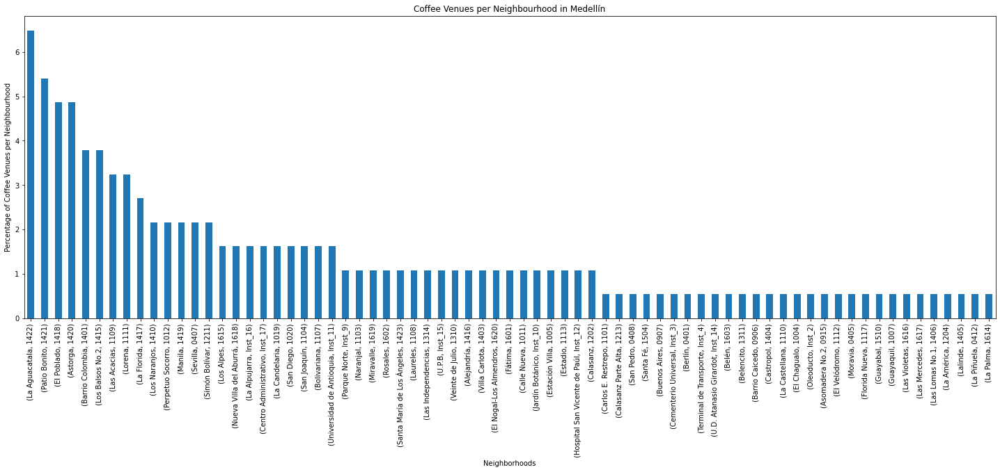

In [97]:
df_group_neigh_bar['Percent'].plot(kind='bar', figsize=(25, 8))

plt.title('Coffee Venues per Neighbourhood in Medellín') # add a title to the histogram
plt.ylabel('Percentage of Coffee Venues per Neighbourhood') # add y-label
plt.xlabel('Neighborhoods') # add x-label

plt.show()

### Requesting geojson with boroughs geometry

In [67]:
respo = requests.get('https://opendata.arcgis.com/datasets/7a8ad9f85799453e9dab4dc0c8c80bb3_3.geojson').json()

## Dataframe to create a choropleth map per borough.

In [68]:
medellin_borough = respo['features'] #Getting dataframe from json
medellin_borough = pd.json_normalize(medellin_borough) #flatten json

#Cleaning columns
medellin_borough.columns = [col.split(".")[-1] for col in medellin_borough.columns]
medellin_borough.drop(['OBJECTID','IDENTIFICACION','LIMITEMUNICIPIOID','SUBTIPO_COMUNACORREGIMIENTO','LINK_DOCUMENTO','SHAPEAREA','SHAPELEN'], axis=1, inplace=True)
medellin_borough.rename(columns={'CODIGO':'Bor_Id','NOMBRE':'Borough','NOMBRE_COMUNA_CORREGIMIENTO':'Borough','coordinates':'coordinates'}, inplace=True)
medellin_borough = medellin_borough[['Bor_Id','Borough']]
print('The dimensions of this dataframe are: ', medellin.shape)

The dimensions of this dataframe are:  (330, 3)


In [69]:
medellin_borough.head()

,Bor_Id,Borough
0,01,Popular
1,02,Santa Cruz
2,03,Manrique
3,04,Aranjuez
4,05,Castilla


### Merging dataframe that contains borough id's with coffee venues dataframe

Aggregate a % column and sort to know how many coffes there are by borough

In [99]:
df_bor_cafe=pd.merge(medellin_borough,df_neigh_cafe,how='left', on=['Borough'])
df_group_bor_bar = df_bor_cafe.drop(['Neighbourhood','Latitude','Longitude','Venue Latitude','Venue Longitude','Venue Category','Id'], axis=1).groupby(['Borough','Bor_Id']).count()
df_group_bor_bar.sort_values(by=['Venue'], ascending=False, inplace=True)
df_group_bor_bar['Percent'] = (df_group_bor_bar['Venue']/df_group_bor_bar['Venue'].sum())*100
df_group_bor_bar.head(15)

,,Venue,Percent
Borough,Bor_Id,,
El Poblado,14,76,41.081081
Laureles Estadio,11,31,16.756757
La Candelaria,10,24,12.972973
Belén,16,18,9.729730
Aranjuez,04,15,8.108108
La América,12,8,4.324324
San Javier,13,5,2.702703
Castilla,05,3,1.621622
Buenos Aires,09,3,1.621622


## Dataframe to create a choropleth map per borough
The below dataframe is needed to create a bar chart, reseting his index we got a dataframe to create a choropleth map.

In [100]:
df_group_bor_map = df_group_bor_bar.reset_index(level='Bor_Id')
df_group_bor_map

,Bor_Id,Venue,Percent
Borough,,,
El Poblado,14,76,41.081081
Laureles Estadio,11,31,16.756757
La Candelaria,10,24,12.972973
Belén,16,18,9.729730
Aranjuez,04,15,8.108108
La América,12,8,4.324324
San Javier,13,5,2.702703
Castilla,05,3,1.621622
Buenos Aires,09,3,1.621622


# Choropleth Medellín Borough's map

In [101]:
threshold_scale = np.linspace(df_group_bor_map['Percent'].min(),
                              df_group_bor_map['Percent'].max(),
                              6, dtype=int)
threshold_scale = threshold_scale.tolist() # change the numpy array to a list
threshold_scale[-1] = threshold_scale[-1] + 1

boroughmap = folium.Map(location=[latitude, longitude], zoom_start=12)
boroughmap.choropleth(
    geo_data=respo,
    name='Choropleth',
    data=df_group_bor_map,
    columns=['Bor_Id','Percent'],
    key_on='feature.properties.CODIGO',
    fill_color='YlGnBu',
    threshold_scale=threshold_scale,
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Coffee venues per borough in %',
    smooth_factor=0
)
boroughmap

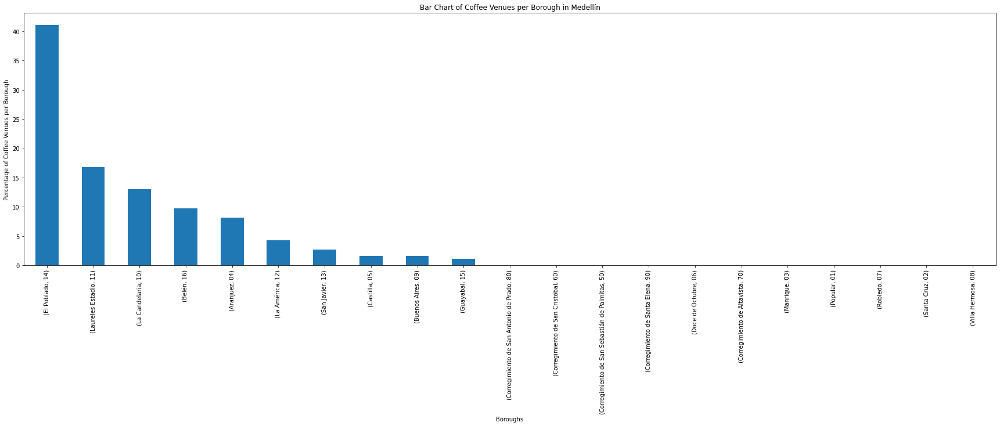

In [102]:
df_group_bor_bar['Percent'].plot(kind='bar', figsize=(30, 8))

plt.title('Bar Chart of Coffee Venues per Borough in Medellín') # add a title to the histogram
plt.ylabel('Percentage of Coffee Venues per Borough') # add y-label
plt.xlabel('Boroughs') # add x-label

plt.show()

## Exploring the first six boroughs with more quantity of coffee venues

In [103]:
df_borough = df_neigh_cafe.drop(['Latitude','Longitude','Venue Latitude','Venue Longitude','Venue Category'], axis=1)
df_borough

,Neighbourhood,Venue,Id,Borough
0,Laureles,De Lolita,1108,Laureles Estadio
1,Laureles,Starbucks,1108,Laureles Estadio
2,Las Mercedes,Cafetto,1617,Belén
3,Perpetuo Socorro,Juan Valdez Café,1012,La Candelaria
4,Perpetuo Socorro,El Portal (San Diego),1012,La Candelaria
...,...,...,...,...
180,Centro Administrativo,De Lolita,Inst_17,La Candelaria
181,Centro Administrativo,Café de los Andes,Inst_17,La Candelaria
182,Los Alpes,O-Cake,1615,Belén
183,Los Alpes,Juan Valdez Café,1615,Belén


In [104]:
poblado_cafe = df_borough[df_borough['Borough'] == 'El Poblado'].groupby(['Borough','Id','Neighbourhood']).count()
poblado_cafe.sort_values(by=['Venue'], ascending=False, inplace=True)
poblado_cafe

Venue
Borough    Id   Neighbourhood                    
El Poblado 1422 La Aguacatala                  12
           1421 Patio Bonito                   10
           1418 El Poblado                      9
           1420 Astorga                         9
           1401 Barrio Colombia                 7
           1415 Los Balsos No.2                 7
           1417 La Florida                      5
           1410 Los Naranjos                    4
           1419 Manila                          4
           1403 Villa Carlota                   2
           1416 Alejandría                      2
           1423 Santa María de Los Ángeles      2
           1404 Castropol                       1
           1405 Lalinde                         1
           1406 Las Lomas No.1                  1

In [105]:
laureles_cafe = df_borough[df_borough['Borough'] == 'Laureles Estadio'].groupby(['Borough','Id','Neighbourhood']).count()
laureles_cafe.sort_values(by=['Venue'], ascending=False, inplace=True)
laureles_cafe

Venue
Borough          Id      Neighbourhood                
Laureles Estadio 1109    Las Acacias                 6
                 1111    Lorena                      6
                 1104    San Joaquín                 3
                 1107    Bolivariana                 3
                 1103    Naranjal                    2
                 1108    Laureles                    2
                 1113    Estadio                     2
                 Inst_15 U.P.B                       2
                 1101    Carlos E. Restrepo          1
                 1110    La Castellana               1
                 1112    El Velódromo                1
                 1117    Florida Nueva               1
                 Inst_14 U.D. Atanasio Girardot      1

In [106]:
lacandelaria_cafe = df_borough[df_borough['Borough'] == 'La Candelaria'].groupby(['Borough','Id','Neighbourhood']).count()
lacandelaria_cafe.sort_values(by=['Venue'], ascending=False, inplace=True)
lacandelaria_cafe

Venue
Borough       Id      Neighbourhood                      
La Candelaria 1012    Perpetuo Socorro                  4
              1019    La Candelaria                     3
              1020    San Diego                         3
              Inst_16 La Alpujarra                      3
              Inst_17 Centro Administrativo             3
              1005    Estación Villa                    2
              1011    Calle Nueva                       2
              Inst_12 Hospital San Vicente de Paúl      2
              1004    El Chagualo                       1
              1007    Guayaquil                         1

In [107]:
belen_cafe = df_borough[df_borough['Borough'] == 'Belén'].groupby(['Borough','Id','Neighbourhood']).count()
belen_cafe.sort_values(by=['Venue'], ascending=False, inplace=True)
belen_cafe

Venue
Borough Id   Neighbourhood                
Belén   1615 Los Alpes                   3
        1618 Nueva Villa del Aburrá      3
        1601 Fátima                      2
        1602 Rosales                     2
        1619 Miravalle                   2
        1620 El Nogal-Los Almendros      2
        1603 Belén                       1
        1614 La Palma                    1
        1616 Las Violetas                1
        1617 Las Mercedes                1

In [108]:
aranjuez_cafe = df_borough[df_borough['Borough'] == 'Aranjuez'].groupby(['Borough','Id','Neighbourhood']).count()
aranjuez_cafe.sort_values(by=['Venue'], ascending=False, inplace=True)
aranjuez_cafe

Venue
Borough  Id      Neighbourhood                  
Aranjuez 0407    Sevilla                       4
         Inst_11 Universidad de Antioquia      3
         Inst_10 Jardín Botánico               2
         Inst_9  Parque Norte                  2
         0401    Berlín                        1
         0405    Moravia                       1
         0408    San Pedro                     1
         0412    La Piñuela                    1

In [109]:
la_america_cafe = df_borough[df_borough['Borough'] == 'La América'].groupby(['Borough','Id','Neighbourhood']).count()
la_america_cafe.sort_values(by=['Venue'], ascending=False, inplace=True)
la_america_cafe

Venue
Borough    Id   Neighbourhood             
La América 1211 Simón Bolívar            4
           1202 Calasanz                 2
           1204 La América               1
           1213 Calasanz Parte Alta      1

# Results

Using our first coffee map (heatmap) created with Foursquare info that shows the concentration of coffee venues in Medellín, we can see that in "El Poblado" are located the most coffee places in the city, this zone contains independent and specialized coffee shops focusing in a specified market and customers that are seeking for quality cups of coffee. Also in "Laureles - Estadio" zone there are quality and specialized coffee venues.

Grouping the dataframe by neighbourhood, we find that "La Aguacatala" neighbourhood located in "El Poblado" borough contains the most quantity of coffee venues, 12 in total and represents 6.38% of all coffee places in the city, as we can see in the heatmap, the most quantity of coffee places are located in "El Poblado" zone.
Based in the grouped neighbourhood dataframe, we created the choropleth map and a bar chart that give us a more complete vision of where is located by neighbourhood the coffe places, confirming our previous results with heat map and grouped dataframe, "El Poblado" and "Laureles - Estadio" zones contains the most of coffee venues in Medellín.

In order to get a better vision and using another dataframe from Alcaldía de Medellín webpage that contains the geometry coordinates of Medellín Borough's we create a grouped dataframe by borough, a choropleth map and a bar chart, with these tools we can see that 41% of coffee venues are located in "El Poblado" borough. For the last, we can see how many places has each neighbourhood by borough.

After this, we can conclude that if you want to put a coffee specialized place in Medellín, the zone with the most quantity of coffees is "El Poblado", but the "Laureles - Estadio" zone maybe can be more interest because there are not exploted enough yet, and can be there a big opportunitie to create a succesful coffee business in this part of the city.